# Covid19 USA 🇺🇸 Visualization & Forecasting

## ![Spark Logo Tiny](https://files.training.databricks.com/images/105/logo_spark_tiny.png)<br>

![](https://schoolnutrition.org/uploadedImages/11COVID-19/covid19.gif)

# Exponential Vs Logistic

### * The Exponential model describes an unstoppable infection growth. For example, if a patient infects 2 patients per day, after 1 day we’ll have 2 infections, 4 after 2 days, 8 after 3 and so on.

### * The Logistic model describes infection growth that is going to stop in the future

In [0]:
import sys
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from bokeh.plotting import figure, save
import plotly.express as px
import plotly.graph_objects as go
import sklearn
import warnings
import pandas as pd
warnings.filterwarnings("ignore")
plt.style.use('ggplot')
pd.plotting.register_matplotlib_converters()
import plotly.figure_factory as ff
import plotly.io as pio
pio.templates.default = "plotly_dark"

### Import the COVID-19 dataset

In [0]:

# os.environ['KAGGLE_USERNAME'] = "xxxxxx" # 
# os.environ['KAGGLE_KEY'] = "xxxxxxxxxxxxxxxxxxxxxxxxxxxx" #
# !kaggle datasets download -d iarunava/happy-house-dataset # api copied from kaggle

In [0]:
corona_data=pd.read_csv('/dbfs/mnt/ADL/Covid19/covid_19_data.csv')

In [0]:
choro_map=px.choropleth(corona_data, 
                    locations="Country/Region", 
                    locationmode = "country names",
                    color="Confirmed", 
                    hover_name="Country/Region", 
                    animation_frame="ObservationDate"
                   )

choro_map.update_layout(
    title_text = 'Global Spread of Coronavirus',
    title_x = 0.5,
    geo=dict(
        showframe = False,
        showcoastlines = False,
    ))
    
choro_map.show();

# The Story of COVID-19 in USA

# Tree plot USA

In [0]:
pd.options.mode.chained_assignment = None

# Read the data

us_df = pd.read_csv('/dbfs/mnt/ADL/Covid19/us_covid19_daily.csv')
us_states_df = pd.read_csv('/dbfs/mnt/ADL/Covid19/us_states_covid19_daily.csv')




us_df["date"] = pd.to_datetime(us_df["date"], format="%Y%m%d")
us_states_df = us_states_df.reindex(index=us_states_df.index[::-1])
us_states_df["date"] = pd.to_datetime(us_states_df["date"], format="%Y%m%d").dt.date.astype(str)
#us_states_df.head()

# US state code to name mapping
state_map_dict = {'AL': 'Alabama',
 'AK': 'Alaska',
 'AS': 'American Samoa',
 'AZ': 'Arizona',
 'AR': 'Arkansas',
 'CA': 'California',
 'CO': 'Colorado',
 'CT': 'Connecticut',
 'DE': 'Delaware',
 'DC': 'District of Columbia',
 'D.C.': 'District of Columbia',
 'FM': 'Federated States of Micronesia',
 'FL': 'Florida',
 'GA': 'Georgia',
 'GU': 'Guam',
 'HI': 'Hawaii',
 'ID': 'Idaho',
 'IL': 'Illinois',
 'IN': 'Indiana',
 'IA': 'Iowa',
 'KS': 'Kansas',
 'KY': 'Kentucky',
 'LA': 'Louisiana',
 'ME': 'Maine',
 'MH': 'Marshall Islands',
 'MD': 'Maryland',
 'MA': 'Massachusetts',
 'MI': 'Michigan',
 'MN': 'Minnesota',
 'MS': 'Mississippi',
 'MO': 'Missouri',
 'MT': 'Montana',
 'NE': 'Nebraska',
 'NV': 'Nevada',
 'NH': 'New Hampshire',
 'NJ': 'New Jersey',
 'NM': 'New Mexico',
 'NY': 'New York',
 'NC': 'North Carolina',
 'ND': 'North Dakota',
 'MP': 'Northern Mariana Islands',
 'OH': 'Ohio',
 'OK': 'Oklahoma',
 'OR': 'Oregon',
 'PW': 'Palau',
 'PA': 'Pennsylvania',
 'PR': 'Puerto Rico',
 'RI': 'Rhode Island',
 'SC': 'South Carolina',
 'SD': 'South Dakota',
 'TN': 'Tennessee',
 'TX': 'Texas',
 'UT': 'Utah',
 'VT': 'Vermont',
 'VI': 'Virgin Islands',
 'VA': 'Virginia',
 'WA': 'Washington',
 'WV': 'West Virginia',
 'WI': 'Wisconsin',
 'WY': 'Wyoming'}

state_code_dict = {v:k for k, v in state_map_dict.items()}
state_code_dict["Chicago"] = 'Illinois'

def correct_state_names(x):
    try:
        return state_map_dict[x.split(",")[-1].strip()]
    except:
        return x.strip()
    
def get_state_codes(x):
    try:
        return state_code_dict[x]
    except:
        return "Others"

covid_19_df = pd.read_csv('/dbfs/mnt/ADL/Covid19/covid_19_data.csv')
us_covid_df = covid_19_df[covid_19_df["Country/Region"]=="US"]
us_covid_df["Province/State"] = us_covid_df["Province/State"].apply(correct_state_names)
us_covid_df["StateCode"] = us_covid_df["Province/State"].apply(lambda x: get_state_codes(x))

In [0]:
statewise_cases = pd.DataFrame(us_covid_df.groupby(['Province/State'])['Confirmed', 'Deaths', 'Recovered'].max().reset_index())
statewise_cases["Country"] = "US" # in order to have a single root node
fig = px.treemap(statewise_cases, path=['Country','Province/State'], values='Confirmed',
                  color='Confirmed', hover_data=['Province/State'],
                  color_continuous_scale='matter')
fig.show();

--------------------------------------------------------------------------- 
 ZeroDivisionError Traceback (most recent call last)
 <command-376520527707487> in <module> 
 3 fig = px.treemap(statewise_cases, path=['Country','Province/State'], values='Confirmed',
 4 color = 'Confirmed' , hover_data = [ 'Province/State' ] , 
 ----> 5 color_continuous_scale='matter')
 6 fig . show ( ) ; 

 /databricks/python/lib/python3.7/site-packages/plotly/express/_chart_types.py in treemap (data_frame, names, values, parents, ids, path, color, color_continuous_scale, range_color, color_continuous_midpoint, color_discrete_sequence, color_discrete_map, hover_name, hover_data, custom_data, labels, title, template, width, height, branchvalues, maxdepth) 
 1453 constructor = go . Treemap , 
 1454 trace_patch = dict ( branchvalues = branchvalues , maxdepth = maxdepth ) , 
 -> 1455 layout_patch = layout_patch , 
 1456 )
 1457 

 /databricks/python/lib/python3.7/site-packages/plotly/express/_core.py in make_figure (args, constructor, trace_patch, layout_patch) 
 1826 args = build_dataframe ( args , constructor ) 
 1827 if constructor in [ go . Treemap , go . Sunburst ] and args [ "path" ] is not None : 
 -> 1828 args = process_dataframe_hierarchy ( args ) 
 1829 if constructor == "timeline" : 
 1830 constructor = go . Bar

 /databricks/python/lib/python3.7/site-packages/plotly/express/_core.py in process_dataframe_hierarchy (args) 
 1555 for i , level in enumerate ( path ) : 
 1556 df_tree = pd . DataFrame ( columns = df_all_trees . columns ) 
 -> 1557 dfg = df . groupby ( path [ i : ] ) . agg ( agg_f ) 
 1558 dfg = dfg . reset_index ( ) 
 1559 # Path label massaging 

 /databricks/python/lib/python3.7/site-packages/pandas/core/groupby/generic.py in aggregate (self, func, *args, **kwargs) 
 938 func = _maybe_mangle_lambdas ( func ) 
 939 
 --> 940 result , how = self . _aggregate ( func , * args , ** kwargs ) 
 941 if how is None : 
 942 return result

 /databricks/python/lib/python3.7/site-packages/pandas/core/base.py in _aggregate (self, arg, *args, **kwargs) 
 426 
 427 try : 
 --> 428 result = _agg ( arg , _agg_1dim ) 
 429 except SpecificationError : 
 430 

 /databricks/python/lib/python3.7/site-packages/pandas/core/base.py in _agg (arg, func) 
 393 result = { } 
 394 for fname , agg_how in arg . items ( ) : 
 --> 395 result [ fname ] = func ( fname , agg_how ) 
 396 return result
 397 

 /databricks/python/lib/python3.7/site-packages/pandas/core/base.py in _agg_1dim (name, how, subset) 
 377 "nested dictionary is ambiguous in aggregation" 
 378 )
 --> 379 return colg . aggregate ( how ) 
 380 
 381 def _agg_2dim ( name , how ) : 

 /databricks/python/lib/python3.7/site-packages/pandas/core/groupby/generic.py in aggregate (self, func, *args, **kwargs) 
 260 
 261 if self . grouper . nkeys > 1 : 
 --> 262 return self . _python_agg_general ( func , * args , ** kwargs ) 
 263 
 264 try : 

 /databricks/python/lib/python3.7/site-packages/pandas/core/groupby/groupby.py in _python_agg_general (self, func, *args, **kwargs) 
 934 pass 
 935 
 --> 936 result , counts = self . grouper . agg_series ( obj , f ) 
 937 assert result is not None 
 938 key = base . OutputKey ( label = name , position = idx ) 

 /databricks/python/lib/python3.7/site-packages/pandas/core/groupby/ops.py in agg_series (self, obj, func) 
 639 
 640 try : 
 --> 641 return self . _aggregate_series_fast ( obj , func ) 
 642 except ValueError as err : 
 643 if "Function does not reduce" in str ( err ) : 

 /databricks/python/lib/python3.7/site-packages/pandas/core/groupby/ops.py in _aggregate_series_fast (self, obj, func) 
 664 group_index = algorithms . take_nd ( group_index , indexer , allow_fill = False ) 
 665 grouper = libreduction . SeriesGrouper ( obj , func , group_index , ngroups , dummy ) 
 --> 666 result , counts = grouper . get_result ( ) 
 667 return result , counts
 668 

 pandas/_libs/reduction.pyx in pandas._libs.reduction.SeriesGrouper.get_result () 

 pandas/_libs/redu

In [0]:
from folium.plugins import HeatMap
m = folium.Map(location = center, zoom_start = 3)

heat_data = [[row['lat'],row['lng']] for index, row in usa_df.iterrows()]
HeatMap(heat_data,radius=16.5, blur = 6.5).add_to(m)



--------------------------------------------------------------------------- 
 NameError Traceback (most recent call last)
 <command-376520527707488> in <module> 
 1 from folium . plugins import HeatMap
 ----> 2 m = folium . Map ( location = center , zoom_start = 3 ) 
 3 
 4 heat_data = [ [ row [ 'lat' ] , row [ 'lng' ] ] for index , row in usa_df . iterrows ( ) ] 
 5 HeatMap ( heat_data , radius = 16.5 , blur = 6.5 ) . add_to ( m ) 

 NameError : name 'folium' is not defined

In [0]:
#statewise_cases
state_details = pd.pivot_table(us_covid_df, values=['Confirmed','Deaths','Recovered'], index='Province/State', aggfunc='max')
state_details['Recovery Rate'] = round(state_details['Recovered'] / state_details['Confirmed'],2)
state_details['Death Rate'] = round(state_details['Deaths'] /state_details['Confirmed'], 2)
state_details = state_details.sort_values(by='Confirmed', ascending= False)
state_details.style.background_gradient(cmap='YlOrRd')

,Confirmed,Deaths,Recovered,Recovery Rate,Death Rate
Province/State,,,,,
California,796436.000000,15291.000000,6.000000,0.000000,0.020000
Texas,742913.000000,15372.000000,0.000000,0.000000,0.020000
Florida,690499.000000,13618.000000,0.000000,0.000000,0.020000
New York,451892.000000,33092.000000,0.000000,0.000000,0.070000
Georgia,310161.000000,6769.000000,0.000000,0.000000,0.020000
Illinois,281303.000000,8744.000000,2.000000,0.000000,0.030000
Arizona,215284.000000,5525.000000,1.000000,0.000000,0.030000
New Jersey,200988.000000,16082.000000,1.000000,0.000000,0.080000
North Carolina,196500.000000,3316.000000,0.000000,0.000000,0.020000


In [0]:
cumulative_df = us_covid_df.groupby("ObservationDate")["Confirmed", "Deaths", "Recovered"].sum().reset_index()

### Plot for number of cumulative covid cases over time
fig = px.bar(cumulative_df, x="ObservationDate", y="Confirmed")
layout = go.Layout(
    title=go.layout.Title(
        text="Daily cumulative count of confirmed COVID-19 cases in US",
        x=0.5
    ),
    font=dict(size=14),
    width=800,
    height=500,
    xaxis_title = "Date of observation",
    yaxis_title = "Number of confirmed cases"
)

fig.update_layout(layout)
fig.show()

### Plot for number of cumulative covid cases over time
fig = px.bar(cumulative_df, x="ObservationDate", y="Deaths")
layout = go.Layout(
    title=go.layout.Title(
        text="Daily cumulative count of deaths due to COVID-19 in US",
        x=0.5
    ),
    font=dict(size=14),
    width=800,
    height=500,
    xaxis_title = "Date of observation",
    yaxis_title = "Number of death cases"
)

fig.update_layout(layout)
fig.show()

### Plot for number of cumulative covid cases over time
cumulative_df["ConfirmedNew"] = cumulative_df["Confirmed"].diff() 
fig = px.bar(cumulative_df, x="ObservationDate", y="ConfirmedNew")
layout = go.Layout(
    title=go.layout.Title(
        text="Daily count of new confirmed COVID-19 cases in US",
        x=0.5
    ),
    font=dict(size=14),
    width=1500,
    height=800,
    xaxis_title = "Date of observation",
    yaxis_title = "Number of confirmed cases"
)

fig.update_layout(layout)
fig.show()


In [0]:
### Plot for number of cumulative covid cases over time
fig = px.bar(cumulative_df, x="ObservationDate", y="Deaths")
layout = go.Layout(
    title=go.layout.Title(
        text="Daily cumulative count of deaths due to COVID-19 in US",
        x=0.5
    ),
    font=dict(size=14),
    width=1500,
    height=800,
    xaxis_title = "Date of observation",
    yaxis_title = "Number of death cases"
)

fig.update_layout(layout)
fig.show()

In [0]:

### Plot for number of cumulative covid cases over time
cumulative_df["ConfirmedNew"] = cumulative_df["Confirmed"].diff() 
fig = px.bar(cumulative_df, x="ObservationDate", y="ConfirmedNew")
layout = go.Layout(
    title=go.layout.Title(
        text="Daily count of new confirmed COVID-19 cases in US",
        x=0.5
    ),
    font=dict(size=14),
    width=1500,
    height=800,
    xaxis_title = "Date of observation",
    yaxis_title = "Number of confirmed cases"
)

fig.update_layout(layout)
fig.show()

In [0]:
import datetime

cumulative_df = us_covid_df.groupby(["StateCode", "ObservationDate"])["Confirmed", "Deaths", "Recovered"].sum().reset_index()
cumulative_df["ObservationDate"] = pd.to_datetime(cumulative_df["ObservationDate"] , format="%m/%d/%Y").dt.date
cumulative_df = cumulative_df.sort_values(by="ObservationDate").reset_index(drop=True)
start_date = datetime.date(2020, 2, 25)
cumulative_df = cumulative_df[cumulative_df["ObservationDate"]>=start_date]
cumulative_df["ObservationDate"] = cumulative_df["ObservationDate"].astype(str)

fig = px.choropleth(locations=cumulative_df["StateCode"],
                    color=cumulative_df["Confirmed"], 
                    locationmode="USA-states",
                    scope="usa",
                    animation_frame=cumulative_df["ObservationDate"],
                    color_continuous_scale='Reds',
                    range_color=[0,55000]
                    #autocolorscale=False,
                   )

layout = go.Layout(
    title=go.layout.Title(
        text="Cumulative count of COVID-19 cases in US states",
        x=0.5
    ),
    font=dict(size=14),
)

fig.update_layout(layout)
fig.show()

In [0]:
cumulative_df = us_covid_df.groupby(["StateCode", "ObservationDate"])["Confirmed", "Deaths", "Recovered"].sum().reset_index()
cumulative_df["ObservationDate"] = pd.to_datetime(cumulative_df["ObservationDate"] , format="%m/%d/%Y").dt.date
cumulative_df = cumulative_df.sort_values(by="ObservationDate").reset_index(drop=True)
start_date = datetime.date(2020, 3, 10)
cumulative_df = cumulative_df[cumulative_df["ObservationDate"]>=start_date]
cumulative_df["ObservationDate"] = cumulative_df["ObservationDate"].astype(str)

fig = px.scatter(cumulative_df, x="Confirmed", y="Deaths", animation_frame="ObservationDate", animation_group="StateCode",
           size="Confirmed", color="StateCode", hover_name="StateCode",
           log_x=False, size_max=55, range_x=[0,55000], range_y=[-20,1000])

layout = go.Layout(
    title=go.layout.Title(
        text="Changes in number of confirmed & death cases over time in US states",
        x=0.5
    ),
    font=dict(size=14),
    xaxis_title = "Total number of confirmed cases",
    yaxis_title = "Total number of death cases"
)

fig.update_layout(layout)

fig.show()

# Testings

In [0]:
us_df.head()

,Confirmed,Deaths,Recovered,day_count,increase,rate,Active
Date,,,,,,,
2020-03-02,101.0,6.0,7.0,1,NaN,NaN,88.0
2020-03-03,122.0,7.0,8.0,2,21.0,0.172131,107.0
2020-03-04,153.0,11.0,8.0,3,31.0,0.202614,134.0
2020-03-05,221.0,12.0,8.0,4,68.0,0.307692,201.0
2020-03-06,278.0,14.0,8.0,5,57.0,0.205036,256.0


In [0]:
fig = px.bar(us_df, x="Date", y="total")

layout = go.Layout(
    title=go.layout.Title(
        text="Cumulative number of Total COVID-19 testing over time in US",
        x=0.5
    ),
    font=dict(size=14),
    width=1500,
    height=800,
    xaxis_title = "Date of observation",
    yaxis_title = "Number of covid-19 testings"
)

fig.update_layout(layout)
fig.show()

--------------------------------------------------------------------------- 
 ValueError Traceback (most recent call last)
 <command-376520527707497> in <module> 
 ----> 1 fig = px . bar ( us_df , x = "Date" , y = "total" ) 
 2 
 3 layout = go.Layout(
 4 title=go.layout.Title(
 5 text = "Cumulative number of Total COVID-19 testing over time in US" , 

 /databricks/python/lib/python3.7/site-packages/plotly/express/_chart_types.py in bar (data_frame, x, y, color, facet_row, facet_col, facet_col_wrap, facet_row_spacing, facet_col_spacing, hover_name, hover_data, custom_data, text, base, error_x, error_x_minus, error_y, error_y_minus, animation_frame, animation_group, category_orders, labels, color_discrete_sequence, color_discrete_map, color_continuous_scale, range_color, color_continuous_midpoint, opacity, orientation, barmode, log_x, log_y, range_x, range_y, title, template, width, height) 
 352 constructor = go . Bar , 
 353 trace_patch = dict ( textposition = "auto" ) , 
 --> 354 layout_patch = dict ( barmode = barmode ) , 
 355 )
 356 

 /databricks/python/lib/python3.7/site-packages/plotly/express/_core.py in make_figure (args, constructor, trace_patch, layout_patch) 
 1824 apply_default_cascade ( args ) 
 1825 
 -> 1826 args = build_dataframe ( args , constructor ) 
 1827 if constructor in [ go . Treemap , go . Sunburst ] and args [ "path" ] is not None : 
 1828 args = process_dataframe_hierarchy ( args ) 

 /databricks/python/lib/python3.7/site-packages/plotly/express/_core.py in build_dataframe (args, constructor) 
 1357 
 1358 df_output, wide_id_vars = process_args_into_dataframe(
 -> 1359 args , wide_mode , var_name , value_name
 1360 )
 1361 

 /databricks/python/lib/python3.7/site-packages/plotly/express/_core.py in process_args_into_dataframe (args, wide_mode, var_name, value_name) 
 1162 if argument == "index" : 
 1163 err_msg += "\n To use the index, pass it in directly as `df.index`." 
 -> 1164 raise ValueError ( err_msg ) 
 1165 elif length and len ( df_input [ argument ] ) != length : 
 1166 raise ValueError(

 ValueError : Value of 'x' is not the name of a column in 'data_frame'. Expected one of ['date', 'states', 'positive', 'negative', 'pending', 'hospitalizedCurrently', 'hospitalizedCumulative', 'inIcuCurrently', 'inIcuCumulative', 'onVentilatorCurrently', 'onVentilatorCumulative', 'recovered', 'dateChecked', 'death', 'hospitalized', 'totalTestResults', 'lastModified', 'total', 'posNeg', 'deathIncrease', 'hospitalizedIncrease', 'negativeIncrease', 'positiveIncrease', 'totalTestResultsIncrease', 'hash'] but received: Date

In [0]:
us_states_df["positive"] = us_states_df["positive"].fillna(0)
us_states_df_CA=us_states_df[us_states_df['state']=='CA']

fig = px.scatter(us_states_df_CA, x="total", y="positive", animation_frame="date", animation_group="state",
           size="positive", color="state", hover_name="state",
           log_x=False, size_max=55, range_x=[0,200000], range_y=[0,55000])

layout = go.Layout(
    title=go.layout.Title(
        text="Total testing counts Vs Positive Counts over time",
        x=0.5
    ),
    font=dict(size=14),
#     width=800,
#     height=500,
    xaxis_title = "Total number of tests",
    yaxis_title = "Number of positive tests"
)

fig.update_layout(layout)
fig.show()

# USA COVID19 Forecasting

# Sigmoid model

In [0]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('fivethirtyeight')
# Any results you write to the current directory are saved as output.
train=pd.read_csv('/dbfs/mnt/ADL/Csv/covid-19-all.csv')

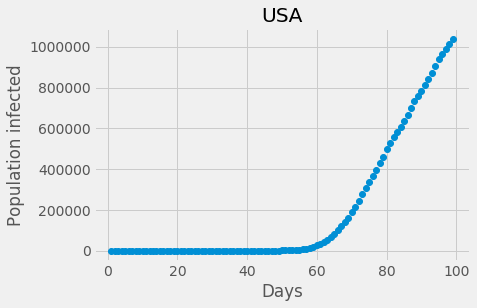

In [0]:
country_df = train[train['Country/Region']=='US'].groupby('Date')['Confirmed','Deaths'].sum()
country_df['day_count'] = list(range(1,len(country_df)+1))
ydata = country_df.Confirmed
xdata = country_df.day_count
country_df['rate'] = (country_df.Confirmed-country_df.Confirmed.shift(1))/country_df.Confirmed
country_df['increase'] = (country_df.Confirmed-country_df.Confirmed.shift(1))

plt.plot(xdata, ydata, 'o')
plt.title("USA")
plt.ylabel("Population infected")
plt.xlabel("Days")
plt.show()

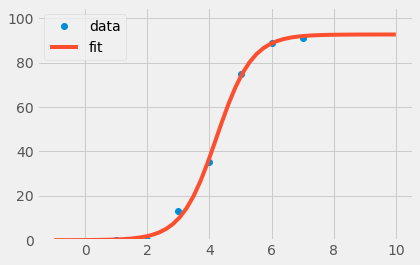

In [0]:
from scipy.optimize import curve_fit
import pylab


def sigmoid(x,c,a,b):
     y = c*1 / (1 + np.exp(-a*(x-b)))
     return y
#country_df.ConfirmedCases
#country_df.day_count
xdata = np.array([1, 2, 3,4, 5, 6, 7])
ydata = np.array([0, 0, 13, 35, 75, 89, 91])

#([low_a,low_b],[high_a,high_b])
#low x --> low b
#high y --> high c
#a is the sigmoidal shape.
popt, pcov = curve_fit(sigmoid, xdata, ydata, method='dogbox',bounds=([0.,0., 0.],[100,2, 10.]))
print(popt)

x = np.linspace(-1, 10, 50)
y = sigmoid(x, *popt)

pylab.plot(xdata, ydata, 'o', label='data')
pylab.plot(x,y, label='fit')
pylab.ylim(-0.05, 105)
pylab.legend(loc='best')
pylab.show()

****Sigmoid function,

fit Sigmoid Function - y = c/(1+np.exp(-a*(x-b))) and 3 coefficients [c, a, b]:

* c - the maximum value (eventual maximum infected people, the sigmoid scales to this value eventually)
* a - the sigmoidal shape (how the infection progress. The smaller, the softer the sigmoidal shape is)
* b - the point where sigmoid start to flatten from steepening (the midpoint of sigmoid, when the rate of increase start to slow down)

In [0]:
us_df = train[train['Country/Region']=='US'].groupby('Date')['Confirmed','Deaths','Recovered'].sum()
us_df = us_df[us_df.Confirmed>=100]

In [0]:
from scipy.optimize import curve_fit
import pylab
from datetime import timedelta

us_df['day_count'] = list(range(1,len(us_df)+1))
us_df['increase'] = (us_df.Confirmed-us_df.Confirmed.shift(1))
us_df['rate'] = (us_df.Confirmed-us_df.Confirmed.shift(1))/us_df.Confirmed
us_df['Active']=us_df['Confirmed']-us_df['Deaths']-us_df['Recovered']


def sigmoid(x,c,a,b):
     y = c*1 / (1 + np.exp(-a*(x-b)))
     return y

xdata = np.array(list(us_df.day_count)[::2])
ydata = np.array(list(us_df.Active)[::2])

population=1.332*10**9
popt, pcov = curve_fit(sigmoid, xdata, ydata, method='dogbox',bounds=([0.,0., 0.],[population,6, 100.]))
print(popt)

[8.89661189e+05 1.35864206e-01 4.05386687e+01]

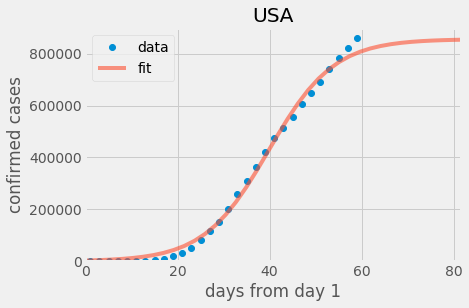

In [0]:
est_a = 8.55738793e+05
est_b = 1.41680856e-01
est_c = 3.98099230e+01
x = np.linspace(-1, us_df.day_count.max()+50, 50)
y = sigmoid(x,est_a,est_b,est_c)
pylab.plot(xdata, ydata, 'o', label='data')
pylab.plot(x,y, label='fit',alpha = 0.6)
pylab.ylim(-0.05, est_a*1.05)
pylab.xlim(-0.05, est_c*2.05)
pylab.legend(loc='best')
plt.xlabel('days from day 1')
plt.ylabel('confirmed cases')
plt.title('USA')
pylab.show()


print('model start date:',us_df[us_df.day_count==1].index[0])
print('model start infection:',int(us_df[us_df.day_count==1].Confirmed[0]))
print('model fitted max Active at:',int(est_a))
print('model sigmoidal coefficient is:',round(est_b,3))
print('model curve stop steepening, start flattening by day:',int(est_c))
print('model curve flattens by day:',int(est_c)*2)
display(us_df.head(3))
display(us_df.tail(3))

# From this, its seen that in case of USA if the graph goes like that:

*     max Active case: 855738 ☠️
*     curve stop steepening, start flattening by day: 39 ,which is: 4/10/2020
*     curve flattens by day: 68 which is: 05/09/2020

Use `%sh ls` to search the folder structure

In [0]:
 %sh ls /dbfs/databricks-datasets/COVID/covid-19-data/

LICENSE
NYT-readme.md
README.md
us-counties.csv
us.csv
us-states.csv

In [0]:
%sh tail /dbfs/databricks-datasets/COVID/covid-19-data/us-counties.csv

2020-04-25,Lincoln,Wyoming,56023,6,0
2020-04-25,Natrona,Wyoming,56025,39,0
2020-04-25,Niobrara,Wyoming,56027,1,0
2020-04-25,Park,Wyoming,56029,1,0
2020-04-25,Sheridan,Wyoming,56033,12,0
2020-04-25,Sublette,Wyoming,56035,1,0
2020-04-25,Sweetwater,Wyoming,56037,10,0
2020-04-25,Teton,Wyoming,56039,64,1
2020-04-25,Uinta,Wyoming,56041,6,0
2020-04-25,Washakie,Wyoming,56043,4,0

In [0]:
%sh ls /dbfs/databricks-datasets/COVID/

CORD-19
coronavirusdataset
covid-19-data
CSSEGISandData
ESRI_hospital_beds
IHME
USAFacts

In [0]:

covid=spark.read.csv("dbfs:/mnt/ADL/Csv/Covid_04_17_2020.csv", header="true", inferSchema="true")
covid.show()

+-----+---------+--------------+--------------+-------------------+------------------+-------------------+---------+------+---------+------+--------------------+
 FIPS| Admin2|Province_State|Country_Region| Last_Update| Lat| Long_|Confirmed|Deaths|Recovered|Active| Combined_Key\|
+-----+---------+--------------+--------------+-------------------+------------------+-------------------+---------+------+---------+------+--------------------+
45001|Abbeville|South Carolina| US|2020-04-17 23:30:52| 34.22333378| -82.46170658| 10| 0| 0| 10|Abbeville, South ...|
22001| Acadia| Louisiana| US|2020-04-17 23:30:52|30.295064899999996| -92.41419698| 110| 6| 0| 104|Acadia, Louisiana...|
51001| Accomack| Virginia| US|2020-04-17 23:30:52| 37.76707161| -75.63234615| 28| 0| 0| 28|Accomack, Virgini...|
16001| Ada| Idaho| US|2020-04-17 23:30:52| 43.4526575|-116.24155159999998| 576| 9| 0| 567| Ada, Idaho, US"\|
19001| Adair| Iowa| US|2020-04-17 23:30:52| 41.33075609| -94.47105874| 1| 0| 0| 1| Adair, Iowa, US"\|
21001| Adair| Kentucky| US|2020-04-17 23:30:52| 37.10459774| -85.28129668| 45| 3| 0| 42|Adair, Kentucky, ...|
29001| Adair| Missouri| US|2020-04-17 23:30:52| 40.19058551| -92.60078167| 12| 0| 0| 12|Adair, Missouri, ...|
40001| Adair| Oklahoma| US|2020-04-17 23:30:52| 35.88494195| -94.65859267| 29| 3| 0| 26|Adair, Oklahoma, ...|
 8001| Adams| Colorado| US|2020-04-17 23:30:52| 39.87432092| -104.3362578| 805| 29| 0| 776|Adams, Colorado, ...|
16003| Adams| Idaho| US|2020-04-17 23:30:52| 44.89333571| -116.4545247| 1| 0| 0| 1| Adams, Idaho, US"\|
17001| Adams| Illinois| US|2020-04-17 23:30:52| 39.98815591| -91.18786813| 30| 0| 0| 30|Adams, Illinois, ...|
18001| Adams| Indiana| US|2020-04-17 23:30:52| 40.7457653| -84.93671406| 6| 1| 0| 5|Adams, Indiana, US"\|
28001| Adams| Mississippi| US|2020-04-17 23:30:52| 31.47669768| -91.35326037| 73| 5| 0| 68|Adams, Mississipp...|
31001| Adams| Nebraska| US|2020-04-17 23:30:52| 40.52449420000001| -98.50117804| 64| 0| 0| 64|Adams, Nebraska, ...|
39001| Adams| Ohio| US|2020-04-17 23:30:52| 38.84541072| -83.4718964| 3| 0| 0| 3| Adams, Ohio, US"\|
42001| Adams| Pennsylvania| US|2020-04-17 23:30:52| 39.87140411| -77.21610347| 70| 1| 0| 69|Adams, Pennsylvan...|
53001| Adams| Washington| US|2020-04-17 23:30:52| 46.98299757|-118.56017340000001| 40| 0| 0| 40|Adams, Washington...|
55001| Adams| Wisconsin| US|2020-04-17 23:30:52| 43.96974651| -89.76782777| 4| 1| 0| 3|Adams, Wisconsin,...|
50001| Addison| Vermont| US|2020-04-17 23:30:52| 44.03217337| -73.14130877| 57| 1| 0| 56|Addison, Vermont,...|
45003| Aiken|South Carolina| US|2020-04-17 23:30:52| 33.54338026| -81.63645384| 66| 3| 0| 63|Aiken, South Caro...|
+-----+---------+--------------+--------------+-------------------+------------------+-------------------+---------+------+---------+------+--------------------+
only showing top 20 rows

In [0]:


df = pd.read_csv("/dbfs/databricks-datasets/COVID/CSSEGISandData/csse_covid_19_data/csse_covid_19_daily_reports/04-26-2020.csv")

df

,FIPS,Admin2,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,Combined_Key
0,45001.0,Abbeville,South Carolina,US,2020-04-27 02:30:52,34.223334,-82.461707,27,0,0,27,"Abbeville, South Carolina, US"
1,22001.0,Acadia,Louisiana,US,2020-04-27 02:30:52,30.295065,-92.414197,130,7,0,123,"Acadia, Louisiana, US"
2,51001.0,Accomack,Virginia,US,2020-04-27 02:30:52,37.767072,-75.632346,187,3,0,184,"Accomack, Virginia, US"
3,16001.0,Ada,Idaho,US,2020-04-27 02:30:52,43.452658,-116.241552,650,15,0,635,"Ada, Idaho, US"
4,19001.0,Adair,Iowa,US,2020-04-27 02:30:52,41.330756,-94.471059,1,0,0,1,"Adair, Iowa, US"
5,21001.0,Adair,Kentucky,US,2020-04-27 02:30:52,37.104598,-85.281297,83,9,0,74,"Adair, Kentucky, US"
6,29001.0,Adair,Missouri,US,2020-04-27 02:30:52,40.190586,-92.600782,12,0,0,12,"Adair, Missouri, US"
7,40001.0,Adair,Oklahoma,US,2020-04-27 02:30:52,35.884942,-94.658593,55,3,0,52,"Adair, Oklahoma, US"
8,8001.0,Adams,Colorado,US,2020-04-27 02:30:52,39.874321,-104.336258,1348,58,0,1290,"Adams, Colorado, US"
9,16003.0,Adams,Idaho,US,2020-04-27 02:30:52,44.893336,-116.454525,3,0,0,3,"Adams, Idaho, US"


In [0]:


df[(df["Country_Region"] == "US") & (df["Province_State"] == "California") & (df["Admin2"] == "San Diego")]

,Admin2,Province_State,Country_Region,Last_Update,Lat,Long_,Confirmed,Deaths,Recovered,Active,Combined_Key,Date
2246,San Diego,California,US,2020-04-27 02:30:52,33.034846,-116.736533,2943,111,0,2832,"San Diego, California, US",2020-04-26


In [0]:
import glob

path = "/dbfs/databricks-datasets/COVID/CSSEGISandData/csse_covid_19_data/csse_covid_19_daily_reports"
all_files = glob.glob(path + "/*.csv")

dfs = []

for filename in all_files:
  temp_df = pd.read_csv(filename)
  temp_df.columns = [c.replace("/", "_") for c in temp_df.columns]
  temp_df.columns = [c.replace(" ", "_") for c in temp_df.columns]
  
  month, day, year = filename.split("/")[-1].replace(".csv", "").split("-")
  d = datetime.date(int(year), int(month), int(day))
  temp_df["Date"] = d

  dfs.append(temp_df)
  
all_days_df = pd.concat(dfs, axis=0, ignore_index=True, sort=False)
all_days_df = all_days_df.drop(["Latitude", "Longitude", "Lat", "Long_", "FIPS", "Combined_Key", "Last_Update"], axis=1)

How has the disease spread over time?

In [0]:
# Dictionary to get the state codes from state names for US
us_state_abbrev = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    'American Samoa': 'AS',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    'Guam': 'GU',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY'
}

In [0]:
all_days_df_US=all_days_df[all_days_df["Country_Region"] == "US"]
all_days_df_US['Date'] = all_days_df_US['Date'].astype(str)
all_days_df_US['state_code'] = all_days_df_US.apply(lambda x: us_state_abbrev.get(x.Province_State,float('nan')), axis=1)
all_days_df_US['ln(Confirmed)'] = np.log(all_days_df_US.Confirmed + 1)
all_days_df_US['ln(Deaths)'] = np.log(all_days_df_US.Deaths + 1)    
all_days_df_US.tail()
    

,Province_State,Country_Region,Confirmed,Deaths,Recovered,Date,Admin2,Active,state_code,ln(Confirmed),ln(Deaths)
117140,Guam,US,141.0,5.0,0.0,2020-04-26,NaN,136.0,GU,4.955827,1.791759
117166,Northern Mariana Islands,US,14.0,2.0,0.0,2020-04-26,NaN,12.0,MP,2.708050,1.098612
117170,Puerto Rico,US,1371.0,84.0,0.0,2020-04-26,NaN,1287.0,PR,7.224025,4.442651
117174,Recovered,US,0.0,0.0,106988.0,2020-04-26,NaN,-106988.0,NaN,0.000000,0.000000
117189,Virgin Islands,US,57.0,4.0,0.0,2020-04-26,NaN,53.0,VI,4.060443,1.609438


In [0]:
# #Get the top 10 counties
# last_date = df_county.date.max()
# df_cities = df_county[df_county['date']==last_date]
# df_cities = df_county.groupby(['county','state'], as_index=False)['cases','deaths'].sum()
# df_cities = df_cities.nlargest(10,'cases')
# df_cities

# # #Get the trend for top 10 cities
# df_trend = df_county.groupby(['date','county','state'], as_index=False)['cases','deaths'].sum()
# df_trend = df_trend.merge(df_cities, on=['county','state'])
# df_trend
# df_trend.drop(['cases_y','deaths_y'],axis=1, inplace=True)
# df_trend.rename(columns={'cases_x':'Cases', 'deaths_x':'Deaths','state_x':'state'}, inplace=True)
# df_trend

# # # # #Add columns for studying logarithmic trends
# df_trend['ln(Cases)'] = np.log(df_trend['Cases']+1)# Added 1 to remove error due to log(0).
# df_trend['ln(Deaths)'] = np.log(df_trend['Deaths']+1)
# df_trend["County_State"] = df_trend["county"] +","+ df_trend["state"]
# df_trend

,date,county,state,Cases,Deaths,ln(Cases),ln(Deaths),County_State
0,2020-01-24,Cook,Illinois,1,0,0.693147,0.000000,"Cook,Illinois"
1,2020-01-25,Cook,Illinois,1,0,0.693147,0.000000,"Cook,Illinois"
2,2020-01-26,Cook,Illinois,1,0,0.693147,0.000000,"Cook,Illinois"
3,2020-01-27,Cook,Illinois,1,0,0.693147,0.000000,"Cook,Illinois"
4,2020-01-28,Cook,Illinois,1,0,0.693147,0.000000,"Cook,Illinois"
5,2020-01-29,Cook,Illinois,1,0,0.693147,0.000000,"Cook,Illinois"
6,2020-01-30,Cook,Illinois,2,0,1.098612,0.000000,"Cook,Illinois"
7,2020-01-31,Cook,Illinois,2,0,1.098612,0.000000,"Cook,Illinois"
8,2020-02-01,Cook,Illinois,2,0,1.098612,0.000000,"Cook,Illinois"
9,2020-02-02,Cook,Illinois,2,0,1.098612,0.000000,"Cook,Illinois"


In [0]:
#Get the top 10 cities
last_date = all_days_df_US.Date.max()
df_cities = all_days_df_US[all_days_df_US['Date']==last_date]
df_cities = all_days_df_US.groupby(['Admin2','state_code'], as_index=False)['Confirmed','Deaths'].sum()
df_cities = df_cities.nlargest(10,'Confirmed')

#Get the trend for top 10 cities
df_trend = all_days_df_US.groupby(['Date','state_code','Admin2'], as_index=False)['Confirmed','Deaths'].sum()
df_trend = df_trend.merge(df_cities, on=['Admin2','state_code'])
df_trend
df_trend.drop(['Confirmed_y','Deaths_y'],axis=1, inplace=True)
df_trend.rename(columns={'Admin2':'City', 'Confirmed_x':'Cases', 'Deaths_x':'Deaths','state_code':'State'}, inplace=True)

#Add columns for studying logarithmic trends
df_trend['ln(Cases)'] = np.log(df_trend['Cases']+1)# Added 1 to remove error due to log(0).
df_trend['ln(Deaths)'] = np.log(df_trend['Deaths']+1)
df_trend["CityState"] = df_trend["City"] +" "+ df_trend["State"]
df_trend

,Date,State,City,Cases,Deaths,ln(Cases),ln(Deaths),CityState
0,2020-03-22,CA,Los Angeles,407.0,5.0,6.011267,1.791759,Los Angeles CA
1,2020-03-23,CA,Los Angeles,536.0,7.0,6.285998,2.079442,Los Angeles CA
2,2020-03-24,CA,Los Angeles,662.0,11.0,6.496775,2.484907,Los Angeles CA
3,2020-03-25,CA,Los Angeles,812.0,13.0,6.700731,2.639057,Los Angeles CA
4,2020-03-26,CA,Los Angeles,1229.0,21.0,7.114769,3.091042,Los Angeles CA
5,2020-03-27,CA,Los Angeles,1465.0,26.0,7.290293,3.295837,Los Angeles CA
6,2020-03-28,CA,Los Angeles,1465.0,26.0,7.290293,3.295837,Los Angeles CA
7,2020-03-29,CA,Los Angeles,1829.0,32.0,7.512071,3.496508,Los Angeles CA
8,2020-03-30,CA,Los Angeles,2474.0,44.0,7.813996,3.806662,Los Angeles CA
9,2020-03-31,CA,Los Angeles,3019.0,54.0,8.013012,4.007333,Los Angeles CA


In [0]:


fig = px.line(df_trend, x='Date', y='Cases', color='CityState', title='COVID19 Total Confirmed growth for Top US Counties')
fig.show()

Break this down by types of cases

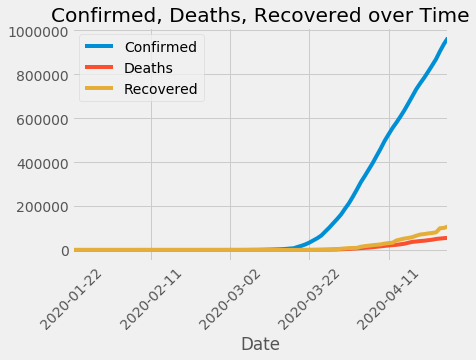

In [0]:
%matplotlib inline
all_days_df_US.groupby("Date")["Confirmed", "Deaths", "Recovered"].sum().plot(title="Confirmed, Deaths, Recovered over Time", rot=45)